# data discription:


The dataset consists of approximately 1,584 images of leaf specimens (16 samples each of 99 species) which have been converted to binary black leaves against white backgrounds. Three sets of features are also provided per image: a shape contiguous descriptor, an interior texture histogram, and a ﬁne-scale margin histogram. For each feature, a 64-attribute vector is given per leaf sample.    

# Get Started (Importing packages & Loading the data)


## Import packages 

In [ ]:
import numpy as np 
import pandas as pd 
import seaborn as sns 
import matplotlib.pyplot as plt 
%matplotlib inline
from sklearn.model_selection import train_test_split,cross_val_score,GridSearchCV,KFold,RandomizedSearchCV
from sklearn.metrics import classification_report,confusion_matrix,roc_curve,precision_score,recall_score,f1_score,precision_recall_curve
sns.set()
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler ,LabelEncoder
from sklearn.svm import SVC
from time import time
from sklearn.svm import LinearSVC
from sklearn.decomposition import PCA

In [ ]:
pd.set_option("display.max_rows", 20)

## Integrating kaggle wih colab to make importing data easier 

In [ ]:
#!pip install --upgrade --force-reinstall --no-deps kaggle
!pip install kaggle
!mkdir ~/.kaggle 

*upload kaggle token* &

agree to terms in the competetion

useful link: https://www.kaggle.com/general/74235 

In [ ]:
from google.colab import files
files.upload() 

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"saraahmedelfetiany","key":"29d14822d57659f31ebcc4f172c8a140"}'}

In [ ]:
from google.colab import files

!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

## Download and process the data from kaggle

In [ ]:
!kaggle competitions download -c leaf-classification

test.csv.zip: Skipping, found more recently modified local copy (use --force to force download)
sample_submission.csv.zip: Skipping, found more recently modified local copy (use --force to force download)
images.zip: Skipping, found more recently modified local copy (use --force to force download)
train.csv.zip: Skipping, found more recently modified local copy (use --force to force download)


In [ ]:
!unzip "train.csv.zip" # extracting files
!unzip "test.csv.zip"
!unzip "images.zip"

## Loading data

In [ ]:
All_train_data = pd.read_csv("train.csv", index_col='id')
test_data = pd.read_csv("test.csv")

In [ ]:
All_train_data.head()

,species,margin1,margin2,margin3,margin4,margin5,margin6,margin7,margin8,margin9,...,texture55,texture56,texture57,texture58,texture59,texture60,texture61,texture62,texture63,texture64
id,,,,,,,,,,,,,,,,,,,,,
1,Acer_Opalus,0.007812,0.023438,0.023438,0.003906,0.011719,0.009766,0.027344,0.0,0.001953,...,0.007812,0.000000,0.002930,0.002930,0.035156,0.0,0.0,0.004883,0.000000,0.025391
2,Pterocarya_Stenoptera,0.005859,0.000000,0.031250,0.015625,0.025391,0.001953,0.019531,0.0,0.000000,...,0.000977,0.000000,0.000000,0.000977,0.023438,0.0,0.0,0.000977,0.039062,0.022461
3,Quercus_Hartwissiana,0.005859,0.009766,0.019531,0.007812,0.003906,0.005859,0.068359,0.0,0.000000,...,0.154300,0.000000,0.005859,0.000977,0.007812,0.0,0.0,0.000000,0.020508,0.002930
5,Tilia_Tomentosa,0.000000,0.003906,0.023438,0.005859,0.021484,0.019531,0.023438,0.0,0.013672,...,0.000000,0.000977,0.000000,0.000000,0.020508,0.0,0.0,0.017578,0.000000,0.047852
6,Quercus_Variabilis,0.005859,0.003906,0.048828,0.009766,0.013672,0.015625,0.005859,0.0,0.000000,...,0.096680,0.000000,0.021484,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.031250


In [ ]:
All_train_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 990 entries, 1 to 1584
Columns: 193 entries, species to texture64
dtypes: float64(192), object(1)
memory usage: 1.5+ MB


In [ ]:
All_train_data.describe()

,margin1,margin2,margin3,margin4,margin5,margin6,margin7,margin8,margin9,margin10,...,texture55,texture56,texture57,texture58,texture59,texture60,texture61,texture62,texture63,texture64
count,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,...,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000,990.000000
mean,0.017412,0.028539,0.031988,0.023280,0.014264,0.038579,0.019202,0.001083,0.007167,0.018639,...,0.036501,0.005024,0.015944,0.011586,0.016108,0.014017,0.002688,0.020291,0.008989,0.019420
std,0.019739,0.038855,0.025847,0.028411,0.018390,0.052030,0.017511,0.002743,0.008933,0.016071,...,0.063403,0.019321,0.023214,0.025040,0.015335,0.060151,0.011415,0.039040,0.013791,0.022768
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.001953,0.001953,0.013672,0.005859,0.001953,0.000000,0.005859,0.000000,0.001953,0.005859,...,0.000000,0.000000,0.000977,0.000000,0.004883,0.000000,0.000000,0.000000,0.000000,0.000977
50%,0.009766,0.011719,0.025391,0.013672,0.007812,0.015625,0.015625,0.000000,0.005859,0.015625,...,0.004883,0.000000,0.005859,0.000977,0.012695,0.000000,0.000000,0.003906,0.002930,0.011719
75%,0.025391,0.041016,0.044922,0.029297,0.017578,0.056153,0.029297,0.000000,0.007812,0.027344,...,0.043701,0.000000,0.022217,0.009766,0.021484,0.000000,0.000000,0.023438,0.012695,0.029297
max,0.087891,0.205080,0.156250,0.169920,0.111330,0.310550,0.091797,0.031250,0.076172,0.097656,...,0.429690,0.202150,0.172850,0.200200,0.106450,0.578130,0.151370,0.375980,0.086914,0.141600


# Data Preprocessing


## check missing values

In [ ]:
All_train_data.isna().sum().sum() # no missing data

0

In [ ]:
test_data.isna().sum().sum()

0

## check duplicates

In [ ]:
All_train_data.duplicated().sum()

0

## encoding the data 

In [ ]:
from sklearn.preprocessing import LabelEncoder

label_encoder = LabelEncoder()

All_train_data['species'] = label_encoder.fit_transform(All_train_data['species'])

In [ ]:
classes = list(label_encoder.classes_)
classes

['Acer_Capillipes',
 'Acer_Circinatum',
 'Acer_Mono',
 'Acer_Opalus',
 'Acer_Palmatum',
 'Acer_Pictum',
 'Acer_Platanoids',
 'Acer_Rubrum',
 'Acer_Rufinerve',
 'Acer_Saccharinum',
 'Alnus_Cordata',
 'Alnus_Maximowiczii',
 'Alnus_Rubra',
 'Alnus_Sieboldiana',
 'Alnus_Viridis',
 'Arundinaria_Simonii',
 'Betula_Austrosinensis',
 'Betula_Pendula',
 'Callicarpa_Bodinieri',
 'Castanea_Sativa',
 'Celtis_Koraiensis',
 'Cercis_Siliquastrum',
 'Cornus_Chinensis',
 'Cornus_Controversa',
 'Cornus_Macrophylla',
 'Cotinus_Coggygria',
 'Crataegus_Monogyna',
 'Cytisus_Battandieri',
 'Eucalyptus_Glaucescens',
 'Eucalyptus_Neglecta',
 'Eucalyptus_Urnigera',
 'Fagus_Sylvatica',
 'Ginkgo_Biloba',
 'Ilex_Aquifolium',
 'Ilex_Cornuta',
 'Liquidambar_Styraciflua',
 'Liriodendron_Tulipifera',
 'Lithocarpus_Cleistocarpus',
 'Lithocarpus_Edulis',
 'Magnolia_Heptapeta',
 'Magnolia_Salicifolia',
 'Morus_Nigra',
 'Olea_Europaea',
 'Phildelphus',
 'Populus_Adenopoda',
 'Populus_Grandidentata',
 'Populus_Nigra',
 'Pr

## check outliers

In [ ]:
from scipy import stats
outlier_foreach_class = []
for c in classes:
  # All_train_data[All_train_data['species'] == c]
  outlier_foreach_class.append((np.abs(stats.zscore(All_train_data[All_train_data['species'] == c])) > 3).sum());
print('number of outliers: {0}\n'.format(np.array(outlier_foreach_class).sum()))

number of outliers: 0



/usr/local/lib/python3.7/dist-packages/scipy/stats/stats.py:2416: RuntimeWarning: Mean of empty slice.
  mns = a.mean(axis=axis, keepdims=True)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:263: RuntimeWarning: Degrees of freedom <= 0 for slice
  keepdims=keepdims, where=where)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:223: RuntimeWarning: invalid value encountered in true_divide
  subok=False)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:252: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


* there is no outliers

# Data visualization

Spices Count


/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


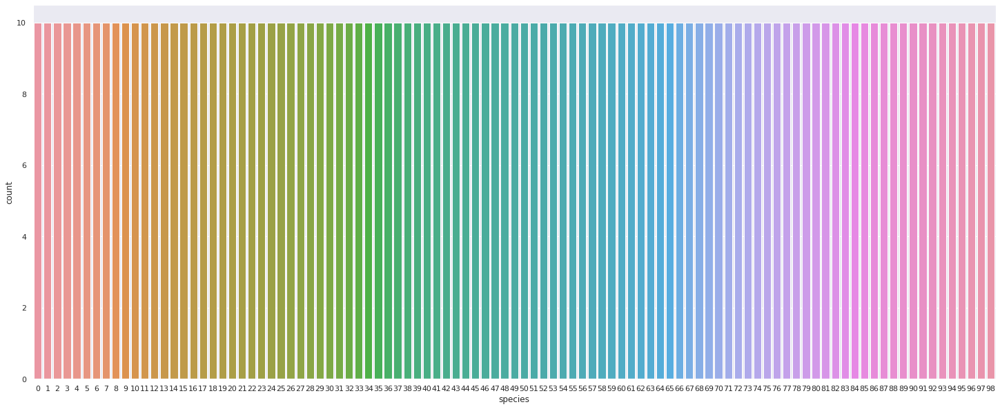

In [ ]:
plt.rcParams["figure.figsize"] = (25,10)
sns.countplot(All_train_data['species'])
plt.show()

Histogram of each feature

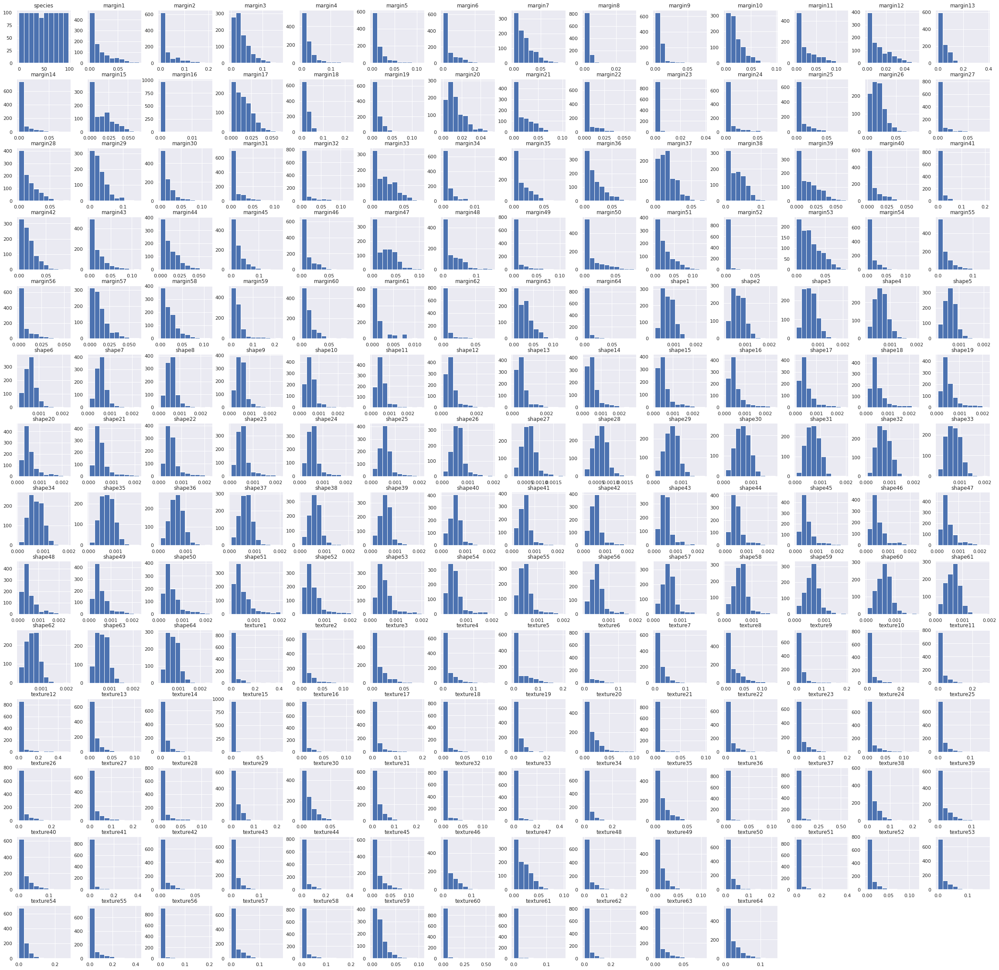

In [ ]:
All_train_data.hist(bins=10, figsize=(40,40))
plt.show()

##Draw some of the images

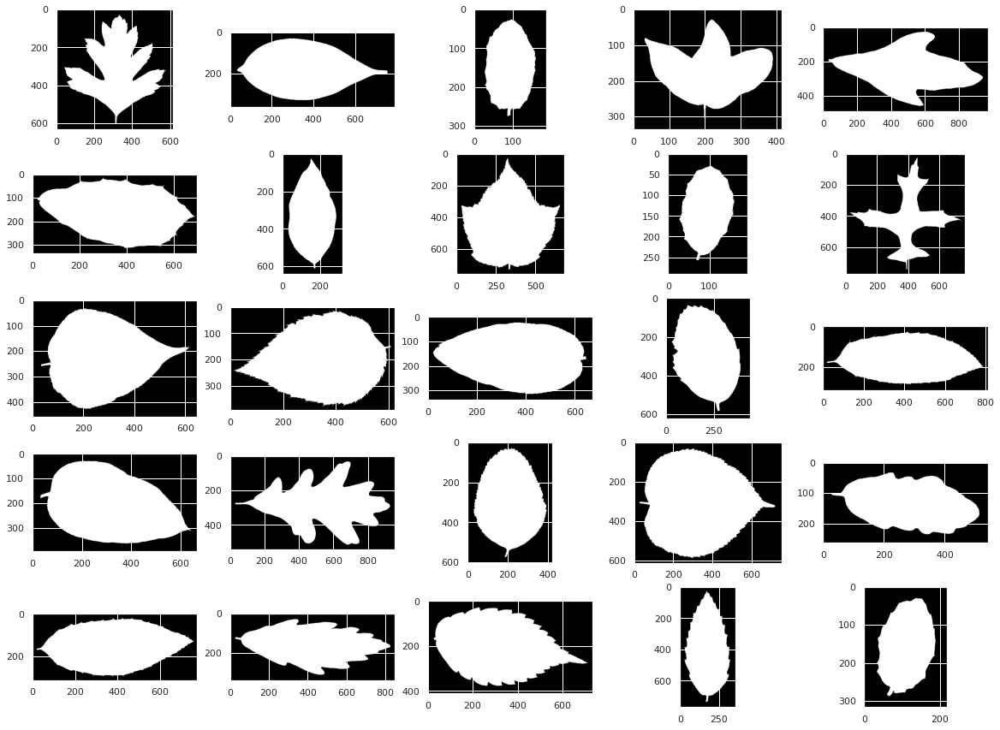

In [ ]:
import matplotlib.pyplot as plt
import os
from keras.preprocessing.image import load_img
plt.figure(figsize=(20,15))

for i in range(25):
    j=np.random.choice((os.listdir('images')))
    plt.subplot(5,5,i+1)
    img=load_img(os.path.join('images',j))
    plt.imshow(img)

##Correlation analysis

We made heatmaps for correlations between:
1. all features together
2. Margin_columns
3. Shape_columns
4. Texture_columns
5. Margin_columns vs Shape_columns
6. Margin_columns vs Texture_columns
7. Shape_columns vs Texture_columns


Text(0.5, 1.0, 'Correlation Matrix')

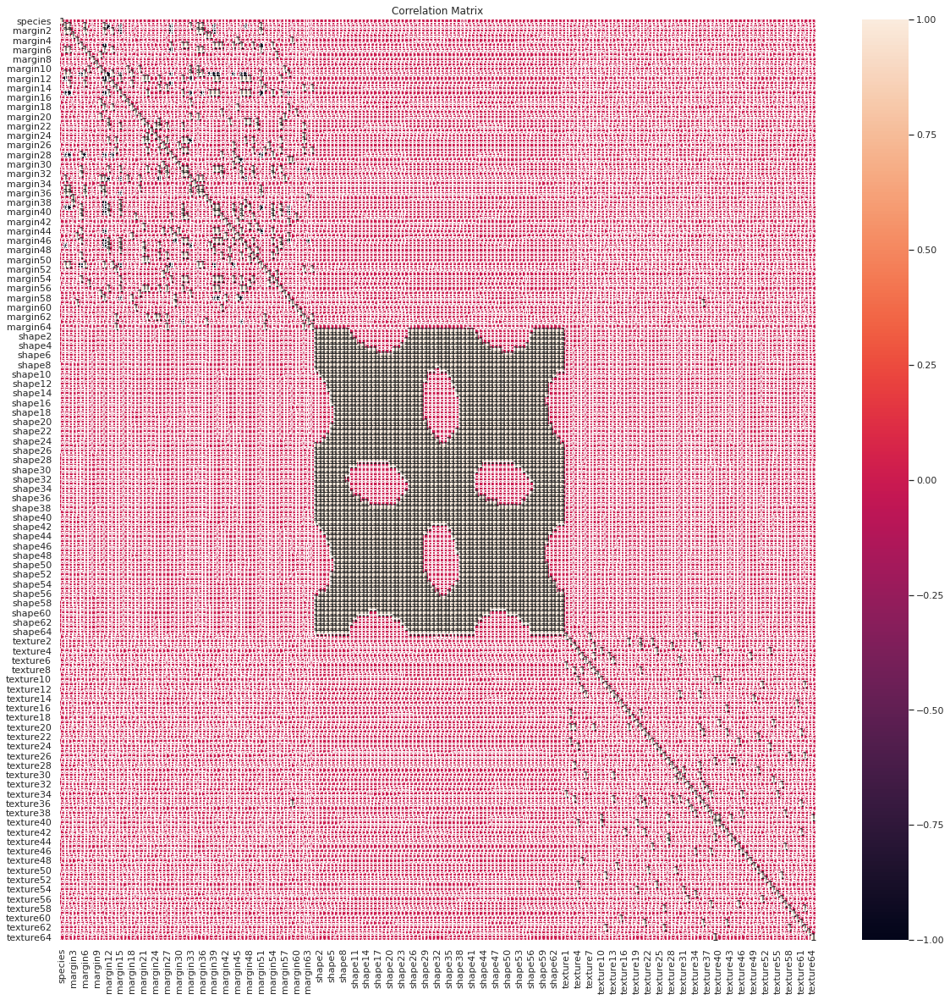

In [ ]:
# all features together
plt.rcParams["figure.figsize"] = (20,20) # Custom figure size in inches
sns.heatmap(All_train_data.corr().round(), annot =True)
plt.title('Correlation Matrix')

In [ ]:
margin_columns = [col for col in All_train_data.columns if 'margin' in col]
shape_columns = [col for col in All_train_data.columns if 'shape' in col]
texture_columns = [col for col in All_train_data.columns if 'texture' in col]

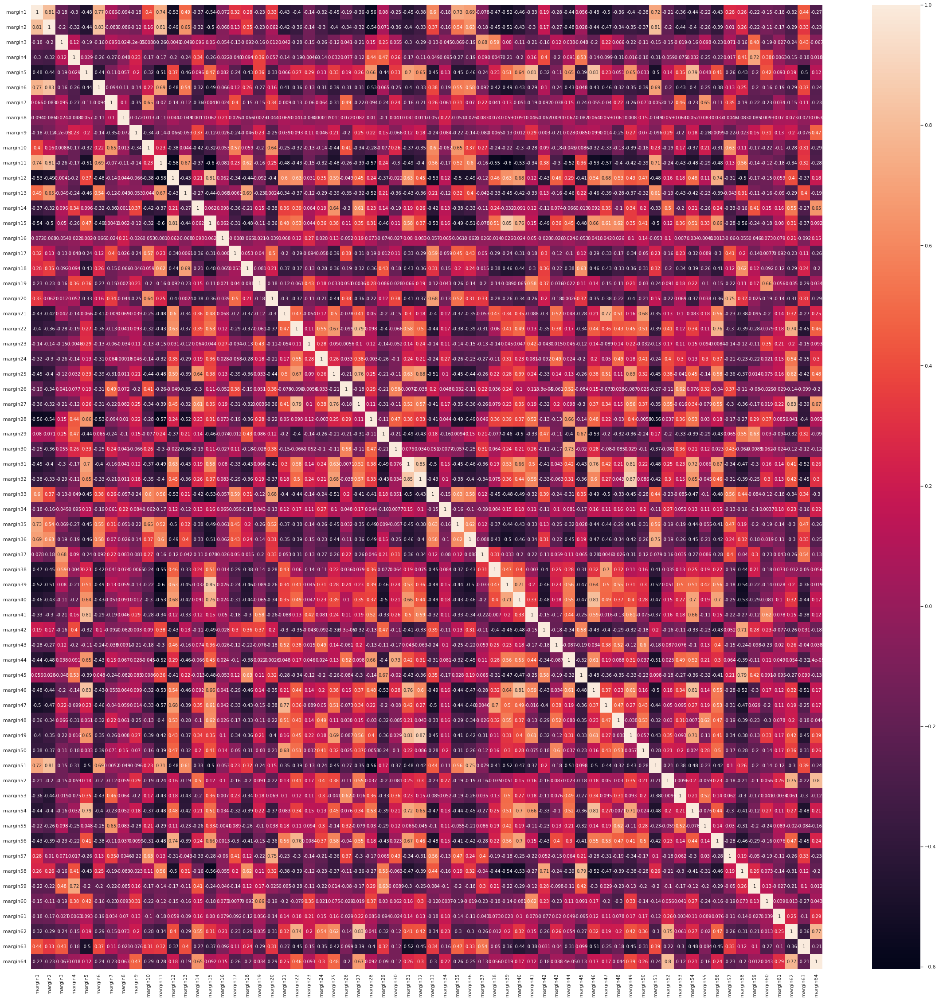

In [ ]:
# Margin_columns
plt.figure(figsize=(40,40))
sns.heatmap(All_train_data[margin_columns].corr(), annot =True);

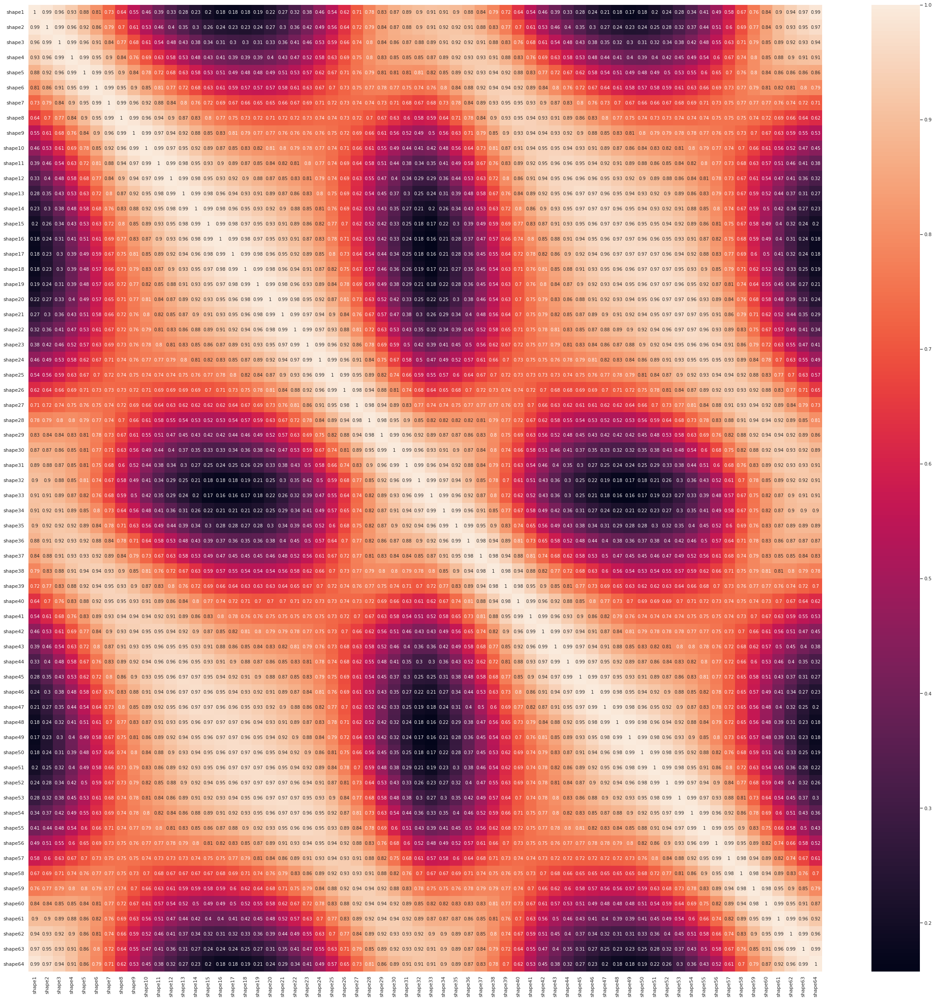

In [ ]:
# Shape_columns
plt.figure(figsize=(40,40))
sns.heatmap(All_train_data[shape_columns].corr(), annot =True);

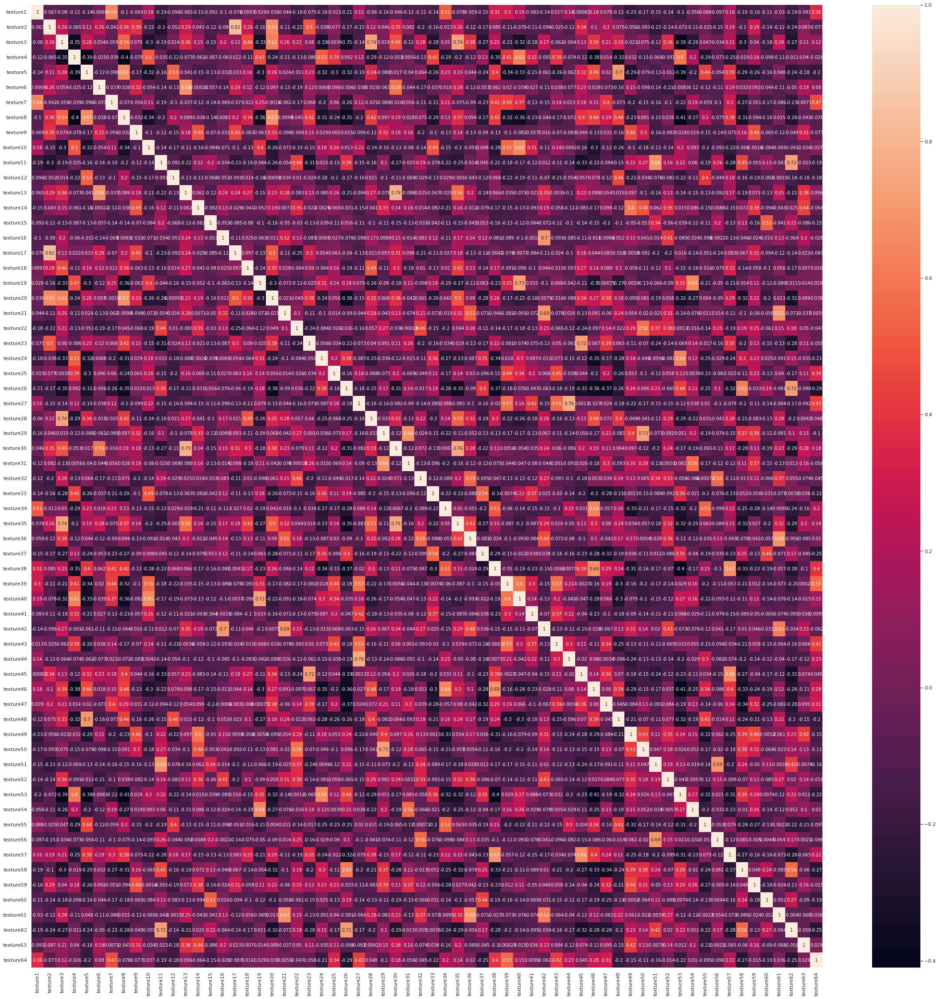

In [ ]:
# Texture_columns
plt.figure(figsize=(40,40))
sns.heatmap(All_train_data[texture_columns].corr(), annot =True);

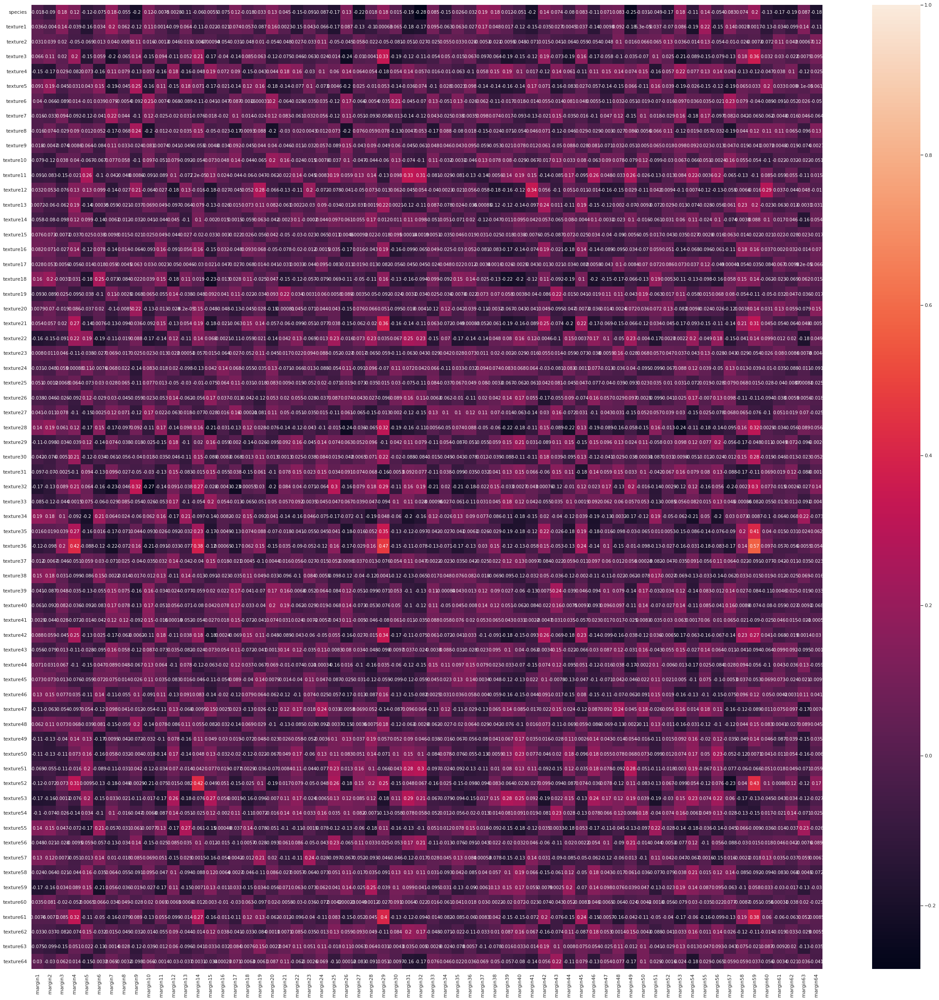

In [ ]:
# Margin_columns vs Texture_columns
plt.figure(figsize=(40,40))
sns.heatmap(All_train_data.corr().filter(margin_columns).drop(margin_columns + shape_columns), annot =True, vmax=1);

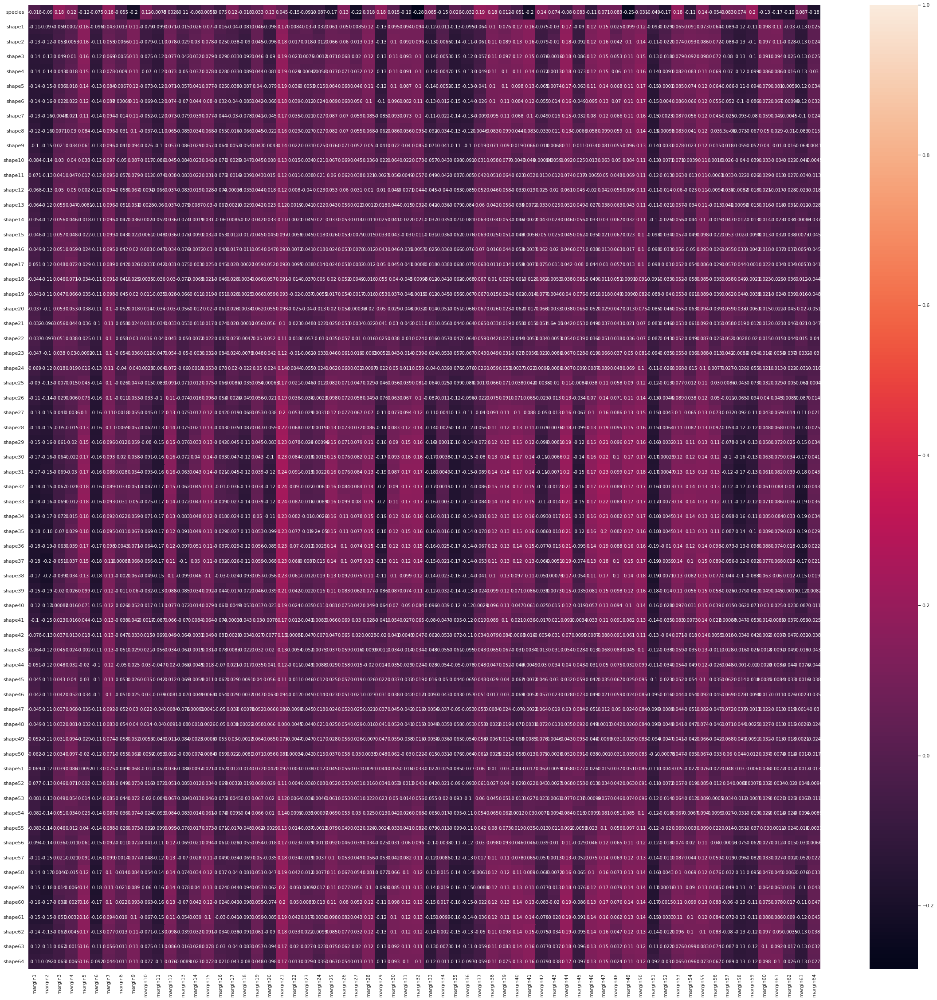

In [ ]:
# Margin_columns vs Shape_columns
plt.figure(figsize=(40,40))
sns.heatmap(All_train_data.corr().filter(margin_columns).drop(margin_columns + texture_columns), annot =True, vmax=1);

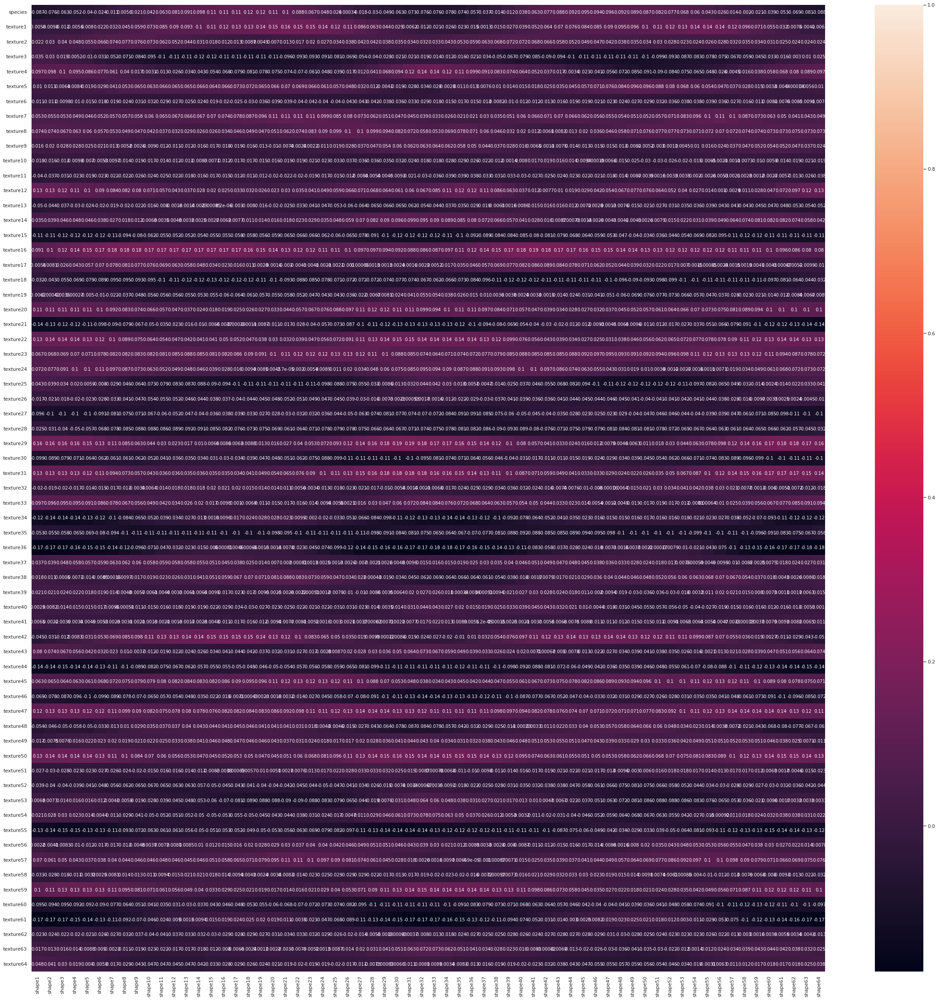

In [ ]:
# Shape_columns vs Texture_columns
plt.figure(figsize=(40,40))
sns.heatmap(All_train_data.corr().filter(shape_columns).drop(margin_columns + shape_columns), annot =True, vmax=1);

# Split the data

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(All_train_data.drop(columns='species'),
                                                    All_train_data['species'], test_size = 0.2, random_state =1)

In [ ]:
from keras.utils.np_utils import to_categorical

y_train_cat = to_categorical(y_train)
y_test_cat = to_categorical(y_test)

#Decide if you need to standardize the data

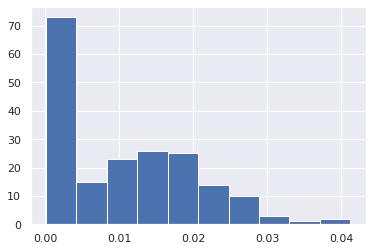

In [ ]:
# x-axis: bins containing mean value
# y-axis: number of features with that mean
All_train_data.iloc[:, All_train_data.columns != 'species'].mean(axis = 0).hist();

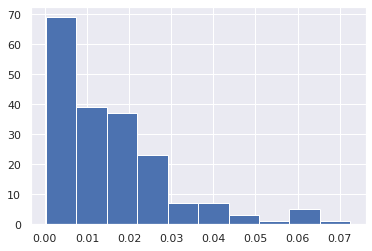

In [ ]:
# x-axis: bins containing std value
# y-axis: number of features with that std
All_train_data.iloc[:, All_train_data.columns != 'species'].std(axis = 0).hist();

# Build simple model using SVM


trial0 : this would be our baseline accuracy that we want to perform better using deep learning


In [ ]:
from sklearn.svm import SVC

classifier_SVC = SVC(gamma=0.1, C=300)

classifier_SVC.fit(X_train,y_train)

print(f'SVM score: ', classifier_SVC.score(X_test,y_test))



SVM score:  0.9393939393939394


# Build the Neural Network 

Note:
for each of the upcoming trials we fist define a model using the build_model function then we used RandomSearch from keras_tuner along with tensorflow board the find the best parameters.

## import tensorflow

In [ ]:
!pip install keras_tuner

In [38]:
from tensorflow.python.keras.initializers.initializers_v2 import Initializer
# The 5-Step Model Life-Cycle
from tensorflow.keras import Sequential , initializers,activations,regularizers 
from tensorflow.keras.layers import Dense 
from keras.layers import Dropout
from keras.layers import LeakyReLU
import keras_tuner as kt
from tensorflow import keras
import tensorboard
import tensorflow as tf
from tensorflow.keras.layers import BatchNormalization



## Trial1: Hidden size and Dropout 
for every number of hidden units there is an optimal dropout rate so we had to search for the best number of nuerons along with the dropout rate simultaneously 

In [ ]:
def build_model(hp):
  model = tf.keras.Sequential()

  model.add(Dense(hp.Int("units", min_value=768, max_value=1024, step=128),# trying 3 hidden size (768,896,1024)
                  kernel_initializer ="glorot_normal", activation='tanh',
                  input_shape = [192,]))

  model.add(Dropout(hp.Choice("dropout_rate", [0.1,0.2,0.3,0.4,0.5]))) # trying 5 dropout rates 

  model.add(Dense(99, activation='softmax')) 

  model.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['acc']) # todo : try adam
  return  model


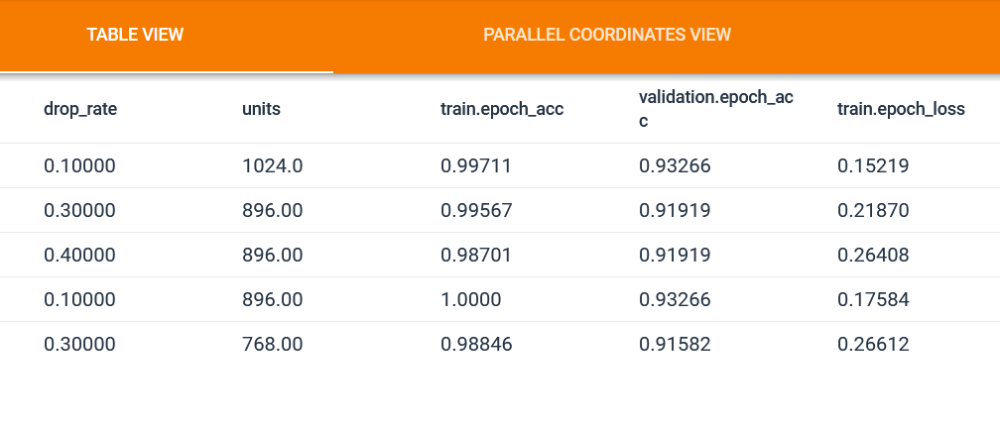

there is a tie between units 1024 and 896 with same dropout rate 0.1, but using 1024 has lower training accuracy and thus less generalization gap ,and also lower loss 

tensorboard of trial 1 :
https://tensorboard.dev/experiment/01GcGpkVTECMLjsOOXL7cg/#hparams

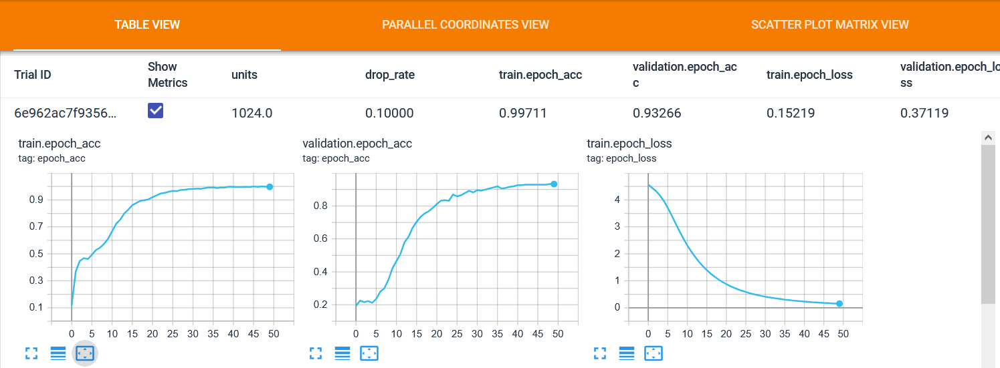

## Trial2 : Fixing the best hidden size and dropout from the last search and searching for the best optimizer

In [ ]:
def build_model(hp):
  model = tf.keras.Sequential()
  # we can either merge the 64 feature or use the whole 192 feature
  # we want to overfit at 1st 
  model.add(Dense(1024,
                  activation='tanh',
                  input_shape = [192,]))
  model.add(Dropout(0.1))
  
  model.add(Dense(99, activation='softmax')) # NUMBER OF CLASSES
  model.compile(optimizer=hp.Choice("optimizer",['SGD', 'RMSprop', 'Adagrad', 'Adadelta', 'Adam', 'Adamax', 'Nadam']), loss='categorical_crossentropy', metrics=['acc']) 
  return  model



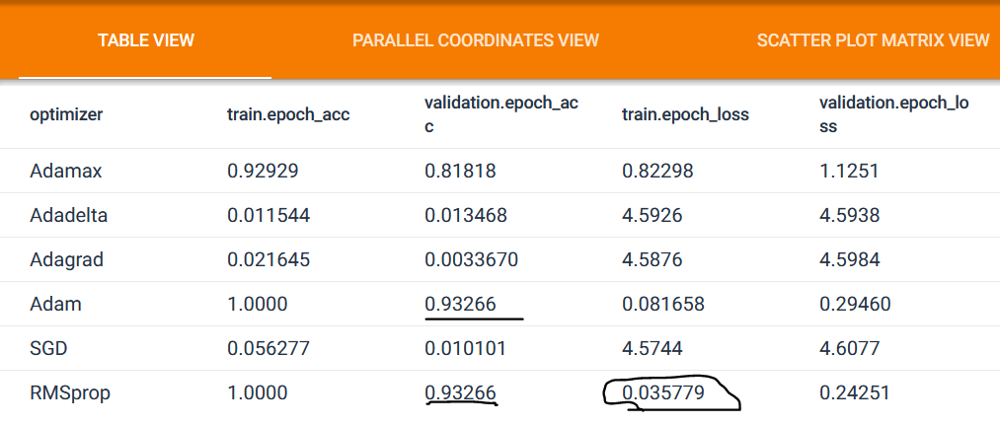

comparing all the optimizer:
https://tensorboard.dev/experiment/gfnaduZ5RDePEMzZrWi9qw/#hparams

there is a tie between Adam and RMSprop, but RMSprop has lower loss

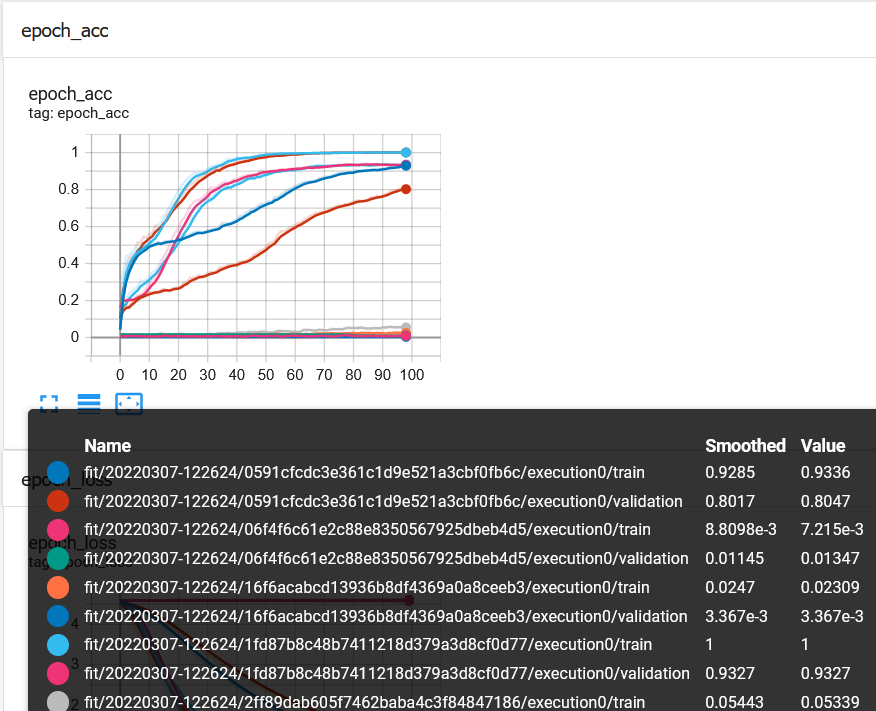

## Trial 3 : adding batch norm


In [ ]:
def build_model(hp):
  model = tf.keras.Sequential()
  # we can either merge the 64 feature or use the whole 192 feature
  # we want to overfit at 1st 
  model.add(Dense(1024,
                  activation='tanh',
                  # kernel_regularizer=tf.keras.regularizers.L2(0.0001),
                  input_shape = [192,]))
  model.add(BatchNormalization()) 

  model.add(Dropout(0.1))
  
  model.add(Dense(99, activation='softmax')) # NUMBER OF CLASSES
  model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['acc']) 
  return  model



the distribution of the inputs to layers deep in the network may change after each mini-batch step, This can cause the model to forever chase a moving target and take longer time, this could be more noticable in deeper neural network

even though in our case we only have one hidden layer it helped in converging faster and reaching a higher validation accuracy 

https://tensorboard.dev/experiment/1LYFO2dhR3uOa6OA7Raq8A/#scalars


running the same model without batchnorm resulted a lower accuracy and the model converged slower for the same step (91% validation accuracy in 80 steps , compared to 96% in the same step)

with batchnorm

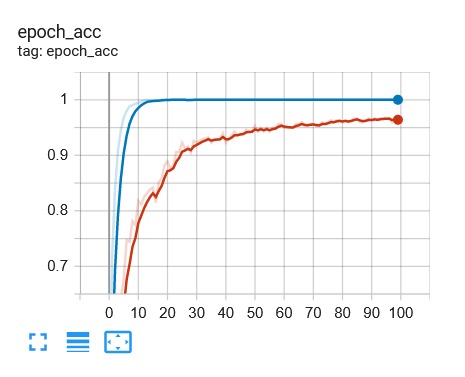

without batchnorm
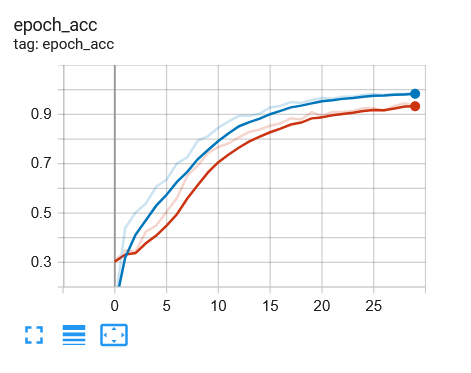

## Trial4 : Finding the best kernel initializer

In [ ]:
def build_model(hp):
  model = tf.keras.Sequential()
  # we can either merge the 64 feature or use the whole 192 feature
  # we want to overfit at 1st 
  model.add(Dense(1024,kernel_initializer = hp.Choice("kernel_initializer",['random_uniform', 'he_normal', 'glorot_normal', 'glorot_uniform']),
                  activation='tanh',
                  input_shape = [192,]))
  model.add(BatchNormalization()) 

  model.add(Dropout(0.1))
  
  model.add(Dense(99, activation='softmax')) # NUMBER OF CLASSES
  model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['acc']) 
  return  model



In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
rm -rf ./logs/ # remove previous log after each run

In [ ]:
import datetime
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


In [ ]:
tuner = kt.RandomSearch(
    build_model,
    directory=log_dir,
    objective='acc',
    max_trials=10)
# early_stopping = EarlyStopping(monitor='val_loss', patience=100)
tuner.search(X_train, y_train_cat, epochs=30, validation_data =(X_test,y_test_cat),callbacks=[tensorboard_callback])


Trial 4 Complete [00h 00m 15s]
acc: 1.0

Best acc So Far: 1.0
Total elapsed time: 00h 01m 02s
INFO:tensorflow:Oracle triggered exit


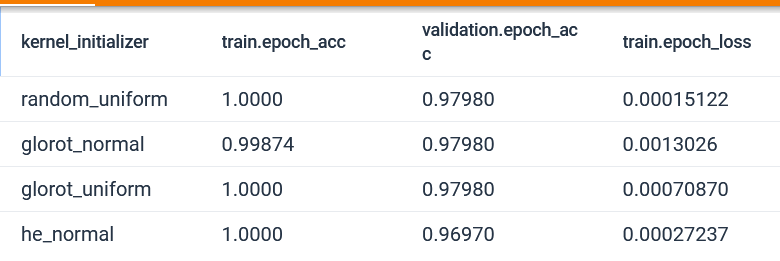

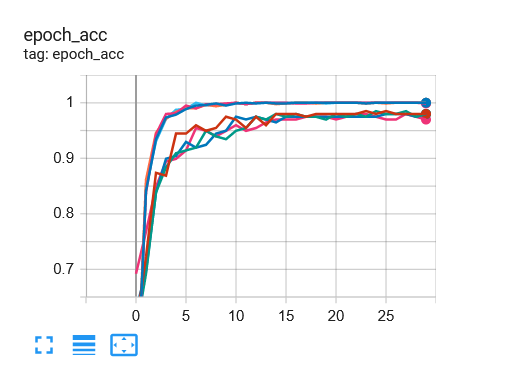

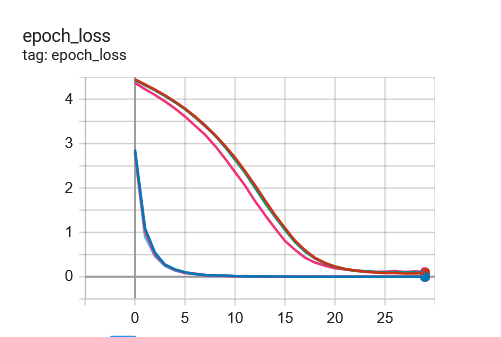

tensorboard of model with different kernel initializers :
https://tensorboard.dev/experiment/EKN2FVWWTvKARgA8XOqV4A/#hparams


changing the kernel intializer didnt affect the final results 

## Trial 5 : Applying standard scaler and l2 reg


IN this trial we will apply StandardScaler on input data which will  compute the mean and standard deviation for each feature dimension using the training set only, then subtracting the mean and dividing by the stdev for each feature and each sample.

that will help in our model training and make the model converge faster and hope to achive higher validation accuracy.

In [39]:
#Scaling Data
scaler = StandardScaler()
x_train_scaled = scaler.fit_transform(X_train)
x_test_scaled = scaler.transform(X_test)

In [62]:
def build_model(hp):
  model = tf.keras.Sequential()
  # we can either merge the 64 feature or use the whole 192 feature
  # we want to overfit at 1st 
  model.add(Dense(1024,
                  kernel_initializer ="glorot_normal", activation='tanh',
                  
                  kernel_regularizer=  tf.keras.regularizers.L2(hp.Choice("regularizer",[0.0001,0.01,0.001])),
                  input_shape = [192,]))
  model.add(BatchNormalization()) 

  model.add(Dropout(0.1))
  
  model.add(Dense(99, activation='softmax')) # NUMBER OF CLASSES
  model.compile(optimizer='rmsprop', loss='categorical_crossentropy', metrics=['acc']) 
  return  model



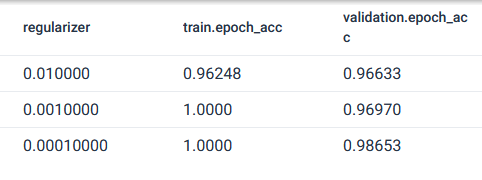

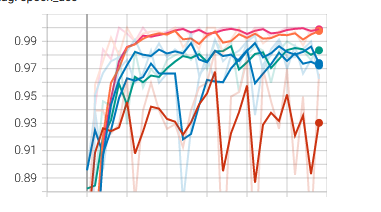

In [63]:
rm -rf ./logs/ # remove previous log after each run

In [64]:
import datetime
log_dir = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)


In [65]:
tuner = kt.RandomSearch(
    build_model,
    directory=log_dir,
    objective='val_acc',
    max_trials=10)
# early_stopping = EarlyStopping(monitor='val_loss', patience=100)
tuner.search(x_train_scaled, y_train_cat, epochs=30, validation_data =(x_test_scaled,y_test_cat),callbacks=[tensorboard_callback])


Trial 3 Complete [00h 00m 13s]
val_acc: 0.9898989796638489

Best val_acc So Far: 0.9898989796638489
Total elapsed time: 00h 00m 54s
INFO:tensorflow:Oracle triggered exit


In [66]:
%tensorboard --logdir logs # the magic line that will get us the learning graphs , document every run and save screen shot of all the failure

Reusing TensorBoard on port 6006 (pid 1341), started 3:15:31 ago. (Use '!kill 1341' to kill it.)

<IPython.core.display.Javascript object>

# Tensor Board

In [ ]:
%tensorboard --logdir logs # the magic line that will get us the learning graphs , document every run and save screen shot of all the failure

In [67]:
!tensorboard dev upload --logdir ./logs \
  --name "L2" \
  --one_shot

2022-03-08 04:48:43.126914: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected

***** TensorBoard Uploader *****

This will upload your TensorBoard logs to https://tensorboard.dev/ from
the following directory:

./logs

This TensorBoard will be visible to everyone. Do not upload sensitive
data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) y

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%

In [ ]:
!tensorboard dev list

2022-03-07 19:34:05.169576: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected
https://tensorboard.dev/experiment/EKN2FVWWTvKARgA8XOqV4A/
	Name                 intializers
	Description          [No Description]
	Id                   EKN2FVWWTvKARgA8XOqV4A
	Created              2022-03-07 19:33:56 (17 seconds ago)
	Updated              2022-03-07 19:34:00 (13 seconds ago)
	Runs                 12
	Tags                 15
	Scalars              720
	Tensor bytes         783088
	Binary object bytes  305952
https://tensorboard.dev/experiment/1r6so7DbRtmYEUY7D68YLg/
	Name                 with_l2
	Description          [No Description]
	Id                   1r6so7DbRtmYEUY7D68YLg
	Created              2022-03-07 17:51:56 (1 hour ago)
	Updated              2022-03-07 17:51:57 (1 hour ago)
	Runs                 3
	Tags                 15
	Scalars              180
	Tensor bytes         195772
	Binary object bytes  

# Training using the best search

In [ ]:
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

In [ ]:
hypermodel = tuner.hypermodel.build(best_hps)


In [ ]:
callback = tf.keras.callbacks.EarlyStopping(monitor='val_acc', patience=10) 

In [ ]:
def train_model(hypermodel):
  history = hypermodel.fit(X_train, y_train_cat, epochs=40 ,batch_size = 192, 
                           validation_data =(X_test,y_test_cat),verbose=2, callbacks=[callback])
  return history

In [ ]:
def evaluation(his):
  print(his.history.keys())
  print('val_acc: ',max(his.history['val_acc']))
  print('val_loss: ',min(his.history['val_loss']))
  print('train_acc: ',max(his.history['acc']))
  print('train_loss: ',min(his.history['loss']))

In [ ]:
evaluation(train_model(hypermodel))

Epoch 1/40
5/5 - 1s - loss: 3.5235 - acc: 0.2803 - val_loss: 4.5023 - val_acc: 0.3232 - 1s/epoch - 283ms/step
Epoch 2/40
5/5 - 0s - loss: 1.8448 - acc: 0.6970 - val_loss: 4.4538 - val_acc: 0.4141 - 112ms/epoch - 22ms/step
Epoch 3/40
5/5 - 0s - loss: 1.2043 - acc: 0.8523 - val_loss: 4.4185 - val_acc: 0.4495 - 118ms/epoch - 24ms/step
Epoch 4/40
5/5 - 0s - loss: 0.8688 - acc: 0.9154 - val_loss: 4.3833 - val_acc: 0.5202 - 116ms/epoch - 23ms/step
Epoch 5/40
5/5 - 0s - loss: 0.6511 - acc: 0.9495 - val_loss: 4.3553 - val_acc: 0.6212 - 115ms/epoch - 23ms/step
Epoch 6/40
5/5 - 0s - loss: 0.5061 - acc: 0.9609 - val_loss: 4.3259 - val_acc: 0.6818 - 109ms/epoch - 22ms/step
Epoch 7/40
5/5 - 0s - loss: 0.3883 - acc: 0.9722 - val_loss: 4.2973 - val_acc: 0.7020 - 113ms/epoch - 23ms/step
Epoch 8/40
5/5 - 0s - loss: 0.3119 - acc: 0.9811 - val_loss: 4.2690 - val_acc: 0.7828 - 110ms/epoch - 22ms/step
Epoch 9/40
5/5 - 0s - loss: 0.2612 - acc: 0.9848 - val_loss: 4.2421 - val_acc: 0.7980 - 99ms/epoch - 20ms/

# honorable mention ! :


https://tensorboard.dev/experiment/7Qe4EhrtRwmT5EOg8oIjBA/

	larger_units_and_dropout
	trying multi units(1024-2048), and multi dropout rate(0.1-0.4) 

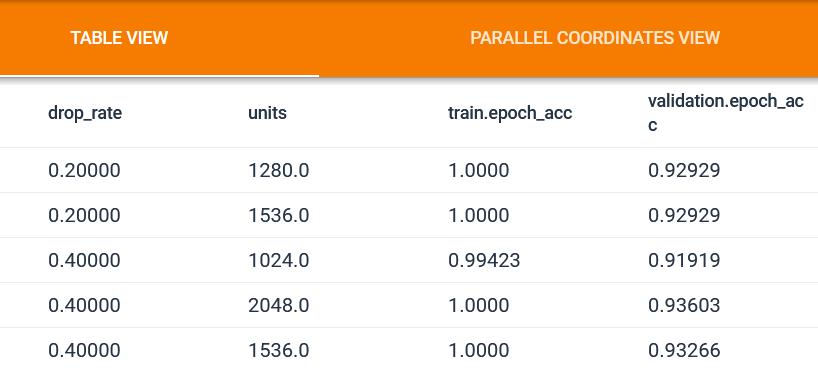

https://tensorboard.dev/experiment/Tg3f4aPGQ3miR9F88QGGRw/

optimizers with dropout

fixing hidden units at 2048 , and multi optimizers and droprate(0.1-0.4) 

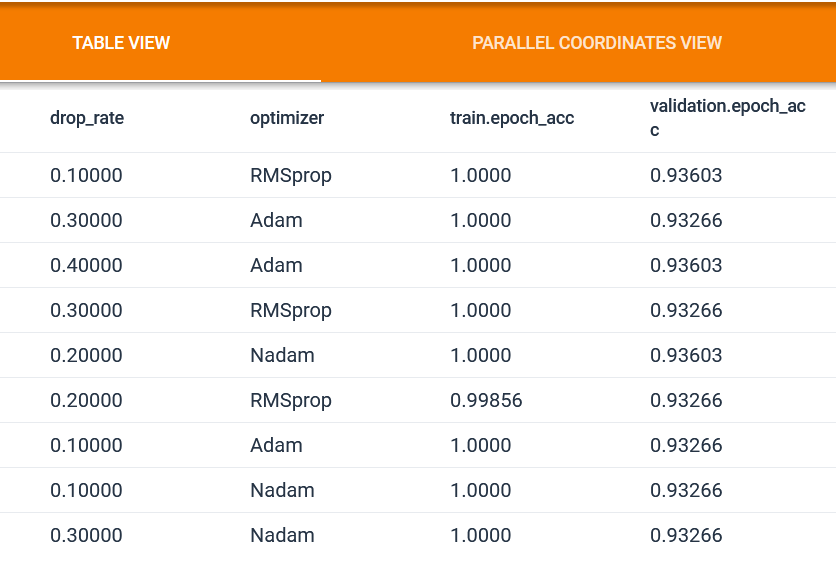

# old trials:


In [ ]:
%tensorboard --logdir logs # the magic line that will get us the learning graphs , document every run and save screen shot of all the failure

In [ ]:
!tensorboard dev list

2022-03-07 18:54:53.128951: E tensorflow/stream_executor/cuda/cuda_driver.cc:271] failed call to cuInit: CUDA_ERROR_NO_DEVICE: no CUDA-capable device is detected

***** TensorBoard Uploader *****

This will list all experiments that you've uploaded to
https://tensorboard.dev. TensorBoard.dev experiments are visible
to everyone. Do not upload sensitive data.

Your use of this service is subject to Google's Terms of Service
<https://policies.google.com/terms> and Privacy Policy
<https://policies.google.com/privacy>, and TensorBoard.dev's Terms of Service
<https://tensorboard.dev/policy/terms/>.

This notice will not be shown again while you are logged into the uploader.
To log out, run `tensorboard dev auth revoke`.

Continue? (yes/NO) y

Please visit this URL to authorize this application: https://accounts.google.com/o/oauth2/auth?response_type=code&client_id=373649185512-8v619h5kft38l4456nm2dj4ubeqsrvh6.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=o